# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 28.03.2024

Мягкий дедлайн: 15.04.2024 23:59 MSK

Жёсткий дедлайн: 21.04.2024 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). 

Сдавать задание после указанного срока сдачи нельзя.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

In [2]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻

Во время выполнения EM у меня стоял примерно такой вопрос 

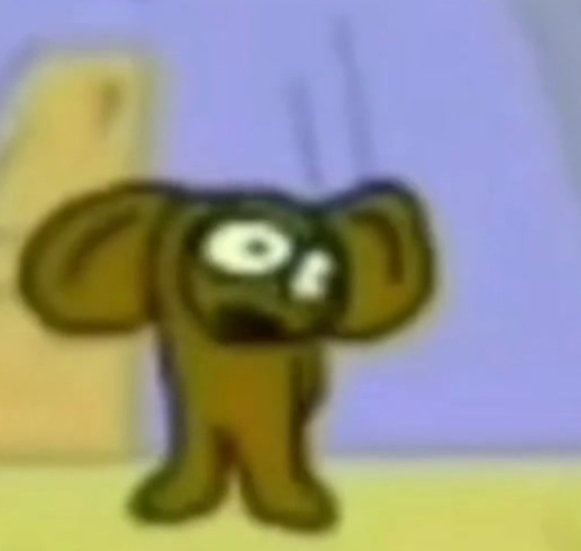

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [3]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans, DBSCAN


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        L = self._get_laplacian(X)
        
        eigenval, eigenvec = np.linalg.eig(L)
        # eigenvec needs to be transposed coz numpy returns the matrix where columns represent desired vectors
        sorted_eigenval = np.argsort(eigenval)[:self.n_components]

        return np.apply_along_axis(lambda x: eigenvec.T[x], axis=0, arr=sorted_eigenval).T.astype(np.float64)
        # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

    def _get_laplacian(self, X):
        '''
        Compute Laplacian 
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_samples) - Laplacian
        '''
        D = np.apply_along_axis(np.sum, axis=1, arr=X)
        return np.diag(D) - X

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [4]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

C:\Users\Max\AppData\Local\Temp\ipykernel_16316\3031837987.py:43: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.apply_along_axis(lambda x: eigenvec.T[x], axis=0, arr=sorted_eigenval).T.astype(np.float64)


Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [5]:
data = pd.read_excel('C:\Work_life\HSE_and_study\ML and DS\FCS ML 2\HA\HA_10_unsupervised\data\\transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [6]:
data.shape

(1037, 16)

Воспользуемся библиотекой `folium` для визуализации данных.

In [7]:
import folium

map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10, popup=row.StationName_en).add_to(map_)
map_

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [8]:
from sklearn.metrics.pairwise import haversine_distances

In [9]:
# Напишу некоторые функции, которые будут использоваться далее

def sort_route(arr, data):
    # do matrix
    matrix = np.zeros(shape=(len(arr), len(arr)))
    for i in range(len(arr)):
        for j in range(len(arr)):
            i_coord = float(data[data['ID_en'] == arr[i]]['Longitude_WGS84_en'].iloc[0]), float(data[data['ID_en'] == arr[i]]['Latitude_WGS84_en'].iloc[0])
            j_coord = float(data[data['ID_en'] == arr[j]]['Longitude_WGS84_en'].iloc[0]), float(data[data['ID_en'] == arr[j]]['Latitude_WGS84_en'].iloc[0])
            matrix[i][j] = distance(i_coord, j_coord)

    first_stop_index = np.argmax( np.mean(matrix, axis=0) )
    output_arr = [int(arr[first_stop_index])]
    arr.pop(first_stop_index)
    itter = first_stop_index
    
    for i in range(matrix.shape[0]):
        matrix[i][i] = 1
    
    while matrix.shape[0] > 1:
        # rewrite so the indexes don't fuck up
        # fixed
        # still need to check if it's correct
        matrix = np.delete(matrix, itter, axis=0)
        closest = np.argmin(matrix[:, itter])
        matrix = np.delete(matrix, itter, axis=1)
        output_arr.append(int(arr[closest]))
        arr.pop(closest)
        itter = closest

    return output_arr


def distance(X, Y):
    return np.max(haversine_distances([[np.radians(i) for i in X], [np.radians(i) for i in Y]]))


def string_to_list(string):
    # The result is not converted into km but kept in some abstract units
    return list(map(lambda x: x.strip(), string.split(';')))

In [10]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''
    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    all_routes = set( sum(list( map(string_to_list, data['RouteNumbers_en'].tolist()) ), []) ) 
    dictionary = { rtu : 0 for rtu in all_routes}
    for key in dictionary:
        dictionary[key] = data[data['RouteNumbers_en'].str.contains(key)]['ID_en'].tolist()

    return dictionary


def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    for key in routes:
        routes[key] = sort_route(routes[key], data)

    return routes


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''
    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    matrix = np.zeros(shape=(data.shape[0], data.shape[0]))
    all_stops = data['ID_en'].tolist()
    for key in sorted_routes:
        for i in range(len(sorted_routes[key]) - 1):
            index_1 = all_stops.index( sorted_routes[key][i] )
            index_2 = all_stops.index( sorted_routes[key][i+1] )
            matrix[index_1][index_2] += 1
            matrix[index_2][index_1] += 1
    return matrix


In [11]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [12]:
map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=13):
    coords =  pd.merge(pd.Series(sorted_routes[route_id], name='ID_en'), data, on='ID_en', how='left')[['Latitude_WGS84_en', 'Longitude_WGS84_en']].values.tolist()
    color = "#"+''.join([np.random.choice(['0','1','2','3','4','5','6','7','8','9','A','B','C','D','E','F']) for j in range(6)])
    folium.vector_layers.PolyLine(coords, color=color).add_to(map_)
map_

Смешно получается, что направление маршрута никак не учитывается, и порой получается так, что авобус зиг загами ездит через сплошную и встречку к остановке через 10 метров)

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [13]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''
    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    data_aug = data.copy(deep=True)
    data_aug['Label'] = labels
    pallette = [("#"+''.join([np.random.choice(['0','1','2','3','4','5','6','7','8','9','A','B','C','D','E','F']) for j in range(6)])) for _ in range(len(data_aug['Label'].unique()))]

    map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
    for _, row in data_aug.iterrows():
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                    radius=10, popup=row.StationName_en, color=pallette[row.Label]).add_to(map_)
    return map_

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`. Подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации (можете поэкспериментировать и оставить в ноутбуке картинки только для итоговых значений параметров, также обратите внимание на баланс объектов в кластерах). Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [14]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
# Спектральная кластеризация
# В функции draw_clustered_map я использовал рандомную генерацию цвета, по этому может понадобиться несколько раз перезапустить код
clusters = 8
model = GraphClustering(n_clusters=clusters, n_components=10)
labels = model.fit_predict(adjacency_matrix)

In [15]:
draw_clustered_map(data, labels)

Можно видеть некоторого рода лучи кляксы ЦАО, определенные этим алгоритмом. Некоторые остановки в силу тех или иных причин были определены в свои собсвенные классы, хотя и находятся внутри других кластеров

In [16]:
from sklearn.preprocessing import StandardScaler

In [17]:
coordinates_data = data[['Latitude_WGS84_en', 'Longitude_WGS84_en']].to_numpy()
scl = StandardScaler()
scaled_coordinates_data = scl.fit_transform(coordinates_data)
raw_KMeans_model = KMeans(n_clusters=clusters)

In [18]:
KMeans_labels = raw_KMeans_model.fit_predict(scaled_coordinates_data)
draw_clustered_map(data, KMeans_labels)

Ну здесь получается разбиение, стандартное для KMeans, можно видеть примерно равные кластеры

In [19]:
DBSCAN_model = DBSCAN(eps=0.0035, min_samples=1)
DBSCAN_Labels = DBSCAN_model.fit_predict(coordinates_data)
draw_clustered_map(data, DBSCAN_Labels)

In [20]:
DBSCAN_model.labels_.max()

62

Здесь получаются кластеры в виде частей маршрутов, выделяются подряд идущие точки маршрутов (ну или не совсем маршрутов)

Проинтерпретируйте полученные результаты. Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:**

- Spectral. С ним не все конкретно понятно. Не полностью разобрался на какого рода кластеры он разбивает данные в конкретном примере. 

- KMeans. Довольно таки понятное и в частности очевидное разбиение по кластерам. Конкретно в данном примере видно четкое разбиение по условным районам (УСЛОВНЫЕ РАЙОНЫ:)). Удобно, что можно указать нужное количество кластеров для разбиения, но в случае с одним центроидом не всегда могут получаться адекватные кластеры.

- DBSCAN. В силу того, что данный алгоритм работает не с количеством кластеров, а с дистанцией между элементами, он определяет в один кластер всех близких соседей точек. На примере это отчетливо видно, точки, которые находятся рядом и идут друг за другом (ну соответственно тоже рядом) определяются в один класс. Не всегда удобно использовать, особенно когда размерность данных очень велика (с текстами очень долго пытался подобрать нужный eps)

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [21]:
data = pd.read_csv('C:\Work_life\HSE_and_study\ML and DS\FCS ML 2\HA\HA_10_unsupervised\data\\bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1384,sport,072.txt,Running around the Olympics,It was back to official duties last week in m...
1322,sport,010.txt,Collins to compete in Birmingham,World and Commonwealth 100m champion Kim Coll...
1095,politics,200.txt,Mallon wades into NE vote battle,Middlesbrough mayor Ray Mallon has been draft...
414,business,415.txt,UK house prices dip in November,"UK house prices dipped slightly in November, ..."
1716,sport,404.txt,Ireland win eclipses refereeing 'errors',The International Rugby Board may have to ste...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [22]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [23]:
import matplotlib.pyplot as plt

In [24]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Error loading punkt: <urlopen error [WinError 10060] A
[nltk_data]     connection attempt failed because the connected party
[nltk_data]     did not properly respond after a period of time, or
[nltk_data]     established connection failed because connected host
[nltk_data]     has failed to respond>
[nltk_data] Error loading wordnet: <urlopen error [WinError 10060] A
[nltk_data]     connection attempt failed because the connected party
[nltk_data]     did not properly respond after a period of time, or
[nltk_data]     established connection failed because connected host
[nltk_data]     has failed to respond>
[nltk_data] Error loading stopwords: <urlopen error [WinError 10060] A
[nltk_data]     connection attempt failed because the connected party
[nltk_data]     did not properly respond after a period of time, or
[nltk_data]     established connection failed because connected host
[nltk_data]     has failed to respond>


In [25]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [26]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [27]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

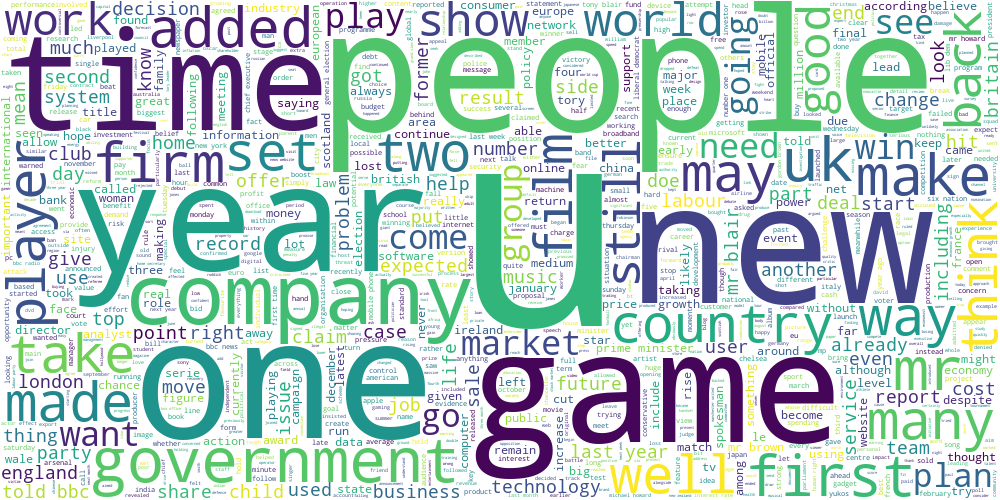

In [28]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**

In [29]:
data['category'].unique()

array(['business', 'entertainment', 'politics', 'sport', 'tech'],
      dtype=object)

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

In [294]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
TF_IDF_vec = TfidfVectorizer(min_df=0.05)
text = data['text']
text_transformed = TF_IDF_vec.fit_transform(text)
TF_IDF_vec.get_feature_names_out()

array(['able', 'access', 'according', 'account', 'accused', 'across',
       'act', 'action', 'actor', 'added', 'admitted', 'agency', 'ago',
       'agreed', 'ahead', 'allow', 'almost', 'already', 'also',
       'although', 'always', 'american', 'among', 'amount', 'analyst',
       'announced', 'annual', 'another', 'anything', 'appeal', 'area',
       'around', 'asked', 'association', 'attack', 'attempt', 'authority',
       'available', 'award', 'away', 'back', 'bank', 'based', 'battle',
       'bbc', 'beat', 'become', 'behind', 'belief', 'believe', 'benefit',
       'best', 'better', 'bid', 'big', 'biggest', 'bill', 'bit', 'blair',
       'board', 'body', 'book', 'boost', 'bos', 'break', 'bring',
       'britain', 'british', 'brought', 'brown', 'business', 'buy', 'ca',
       'call', 'called', 'came', 'campaign', 'card', 'career', 'case',
       'cash', 'centre', 'chairman', 'challenge', 'champion', 'chance',
       'chancellor', 'change', 'charge', 'charles', 'chief', 'child',
     

In [32]:
n_cluster = 6
kmeans = KMeans(n_clusters=n_cluster, random_state=0)
labels = kmeans.fit_predict(text_transformed)

In [33]:
data['labels'] = labels
data.head(5)

,category,filename,title,content,raw_text,text,labels
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...,Ad sales boost Time Warner profit Quarterly pr...,ad sale boost time warner profit quarterly pro...,5
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...,Dollar gains on Greenspan speech The dollar ha...,dollar gain greenspan speech dollar hit highes...,5
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...,Yukos unit buyer faces loan claim The owners o...,yukos unit buyer face loan claim owner embattl...,5
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...,High fuel prices hit BA's profits British Airw...,high fuel price hit ba profit british airway b...,5
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...,Pernod takeover talk lifts Domecq Shares in UK...,pernod takeover talk lift domecq share uk drin...,5


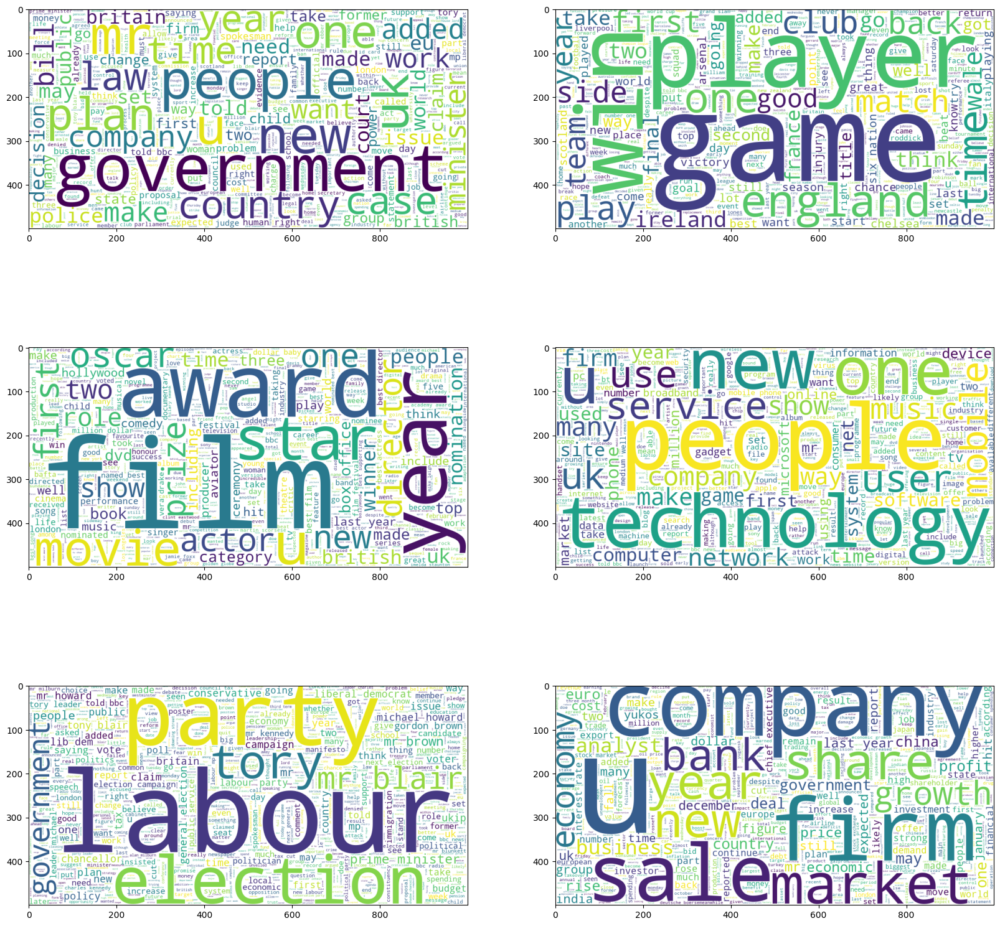

In [34]:
fig, ax = plt.subplots(3,2,figsize=(20,20))

for i in range(n_cluster):
    df = data[data['labels'] == i]    
    ax[i//2][i%2].imshow(draw_wordcloud(df.text));

In [35]:
data.groupby(by='labels').count()

,category,filename,title,content,raw_text,text
labels,,,,,,
0,422,422,422,422,422,422
1,527,527,527,527,527,527
2,218,218,218,218,218,218
3,451,451,451,451,451,451
4,186,186,186,186,186,186
5,421,421,421,421,421,421


Оригинальные кластеры выглядят таким образом:

'business', 'entertainment', 'politics', 'sport', 'tech'

Я попробовал сделать разбиение на 6 кластеров вместо пяти. Их можно проинтерпретировать таким образом (Слева направо, сверху вниз): 

- Политика (международная?) и государство

- Спорт (развлечения?)

- Киноиндустрия

- Технологии

- Трудовая и гражданская политика

- Бизнесс

Интересно, что при разбиении на кластеры из политики выделился отдельный кластер, который скорее всего связан с политикой государства в отношении граждан

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны. Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:**

In [36]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

distance = kmeans.transform(text_transformed)
min_dist = np.argmin(distance, axis=0)
min_dist

array([1185, 1676,  861, 2218, 1151,  200], dtype=int64)

In [37]:
popular_words_per_class = data.iloc[min_dist]
popular_words_per_class

,category,filename,title,content,raw_text,text,labels
1185,politics,290.txt,Terror powers expose 'tyranny',The Lord Chancellor has defended government p...,Terror powers expose 'tyranny' The Lord Chance...,terror power expose lord chancellor defended g...,0
1676,sport,364.txt,A year to remember for Irish,There used to be one subliminal moment during...,A year to remember for Irish There used to be ...,year remember irish used one subliminal moment...,1
861,entertainment,352.txt,Vera Drake's Bafta triumph hope,"At the Bafta film awards on Saturday night, t...",Vera Drake's Bafta triumph hope At the Bafta f...,vera drake bafta triumph hope bafta film award...,2
2218,tech,395.txt,Cebit fever takes over Hanover,Thousands of products and tens of thousands o...,Cebit fever takes over Hanover Thousands of pr...,cebit fever take hanover thousand product ten ...,3
1151,politics,256.txt,Blair pledges unity to Labour MPs,Tony Blair has sought to reassure Labour back...,Blair pledges unity to Labour MPs Tony Blair h...,blair pledge unity labour mp tony blair sought...,4
200,business,201.txt,Novartis hits acquisition trail,Swiss drugmaker Novartis has announced 5.65bn...,Novartis hits acquisition trail Swiss drugmake...,novartis hit acquisition trail swiss drugmaker...,5


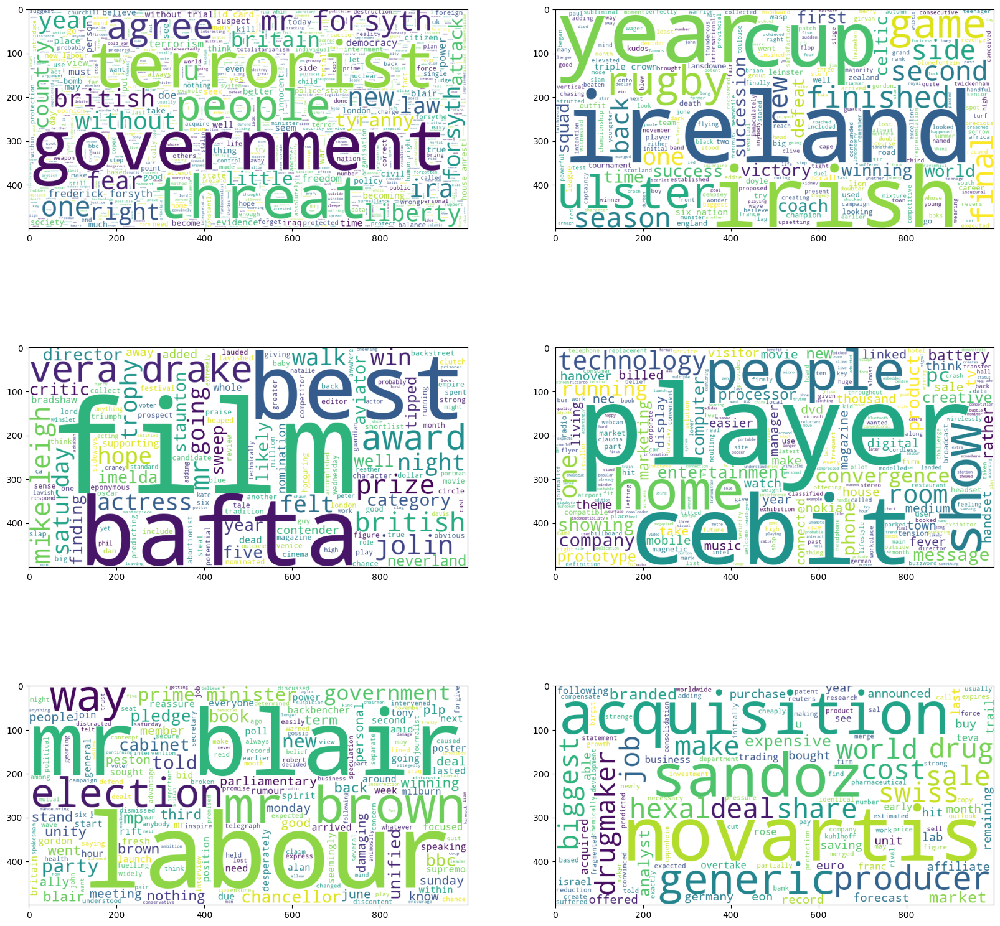

In [38]:
fig, ax = plt.subplots(3,2,figsize=(20,20))

for i in range(n_cluster):
    df = data.iloc[[min_dist[i]]]
    ax[i//2][i%2].imshow(draw_wordcloud(df.text));

Ну, в целом, действительно разделены по тем же самым кластерам, что и в KMeans (неожиданно ахаха).

Интерпретировать WordClouds немного сложнее, тут гораздо больше каких-то абстрактных понятий вроде cebit (если я правильно понял - это какая-то технологическая выставка). Однако в любом случае можно понять за что отвечает каждый представитель

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [284]:
from sklearn.cluster import SpectralClustering
from sklearn.manifold import TSNE

In [40]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
KMeans_text = KMeans(n_clusters=6)
Spectral_text = SpectralClustering(n_clusters=6)

In [41]:
labels_KMeans = KMeans_text.fit_predict(text_transformed)
labels_Spectral = Spectral_text.fit_predict(text_transformed)

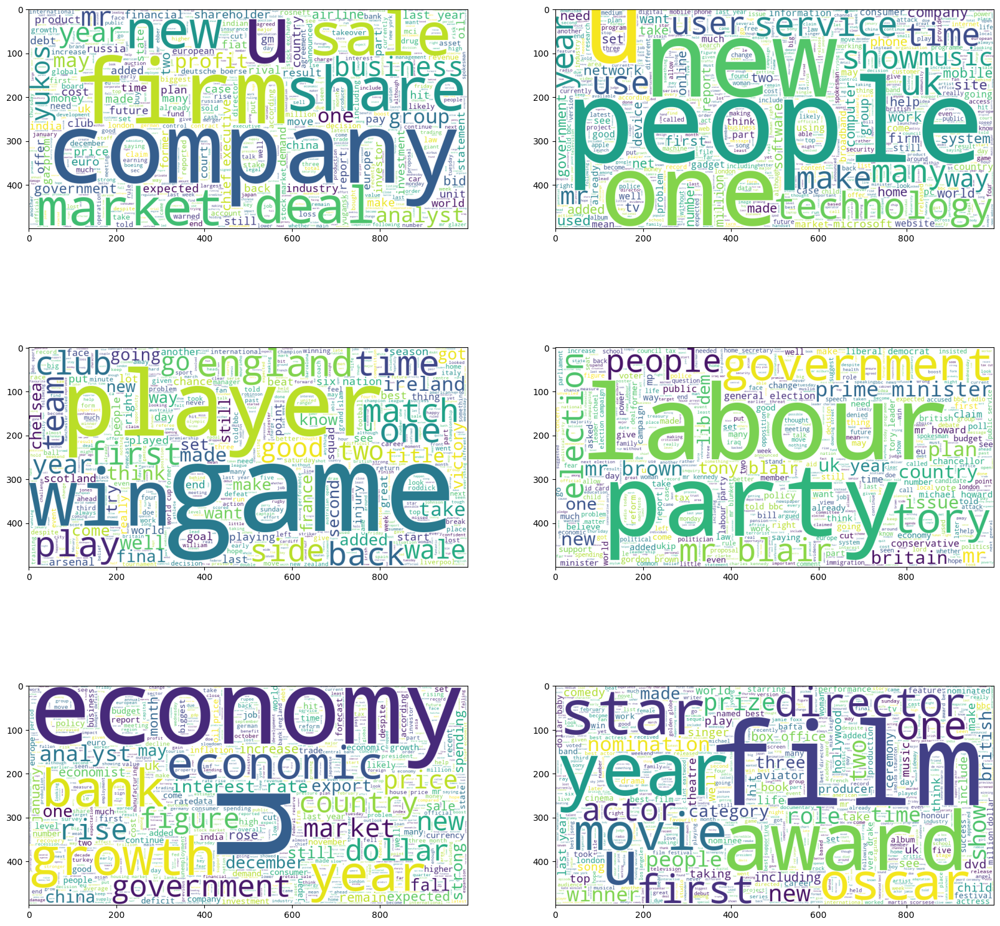

In [42]:
# KMeans
# В целом это представление уже было в первом задании дз

data['labels'] = labels_KMeans
fig, ax = plt.subplots(3,2,figsize=(20,20))

for i in range(n_cluster):
    df = data[data['labels'] == i]    
    ax[i//2][i%2].imshow(draw_wordcloud(df.text));

In [43]:
data.groupby(by='labels').count()

,category,filename,title,content,raw_text,text
labels,,,,,,
0,319,319,319,319,319,319
1,693,693,693,693,693,693
2,541,541,541,541,541,541
3,293,293,293,293,293,293
4,171,171,171,171,171,171
5,208,208,208,208,208,208


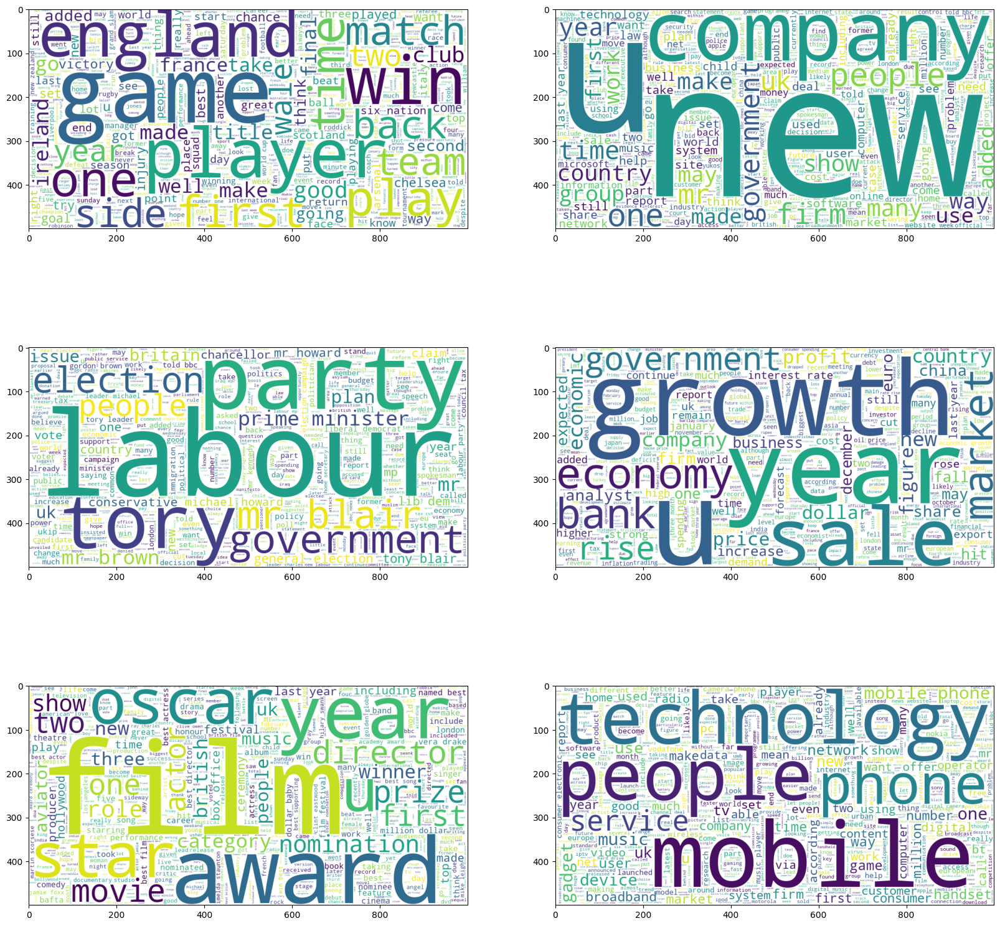

In [44]:
# Spectral

data['labels'] = labels_Spectral
fig, ax = plt.subplots(3,2,figsize=(20,20))

for i in range(n_cluster):
    df = data[data['labels'] == i]    
    ax[i//2][i%2].imshow(draw_wordcloud(df.text));

In [45]:
data.groupby(by='labels').count()

,category,filename,title,content,raw_text,text
labels,,,,,,
0,521,521,521,521,521,521
1,954,954,954,954,954,954
2,232,232,232,232,232,232
3,248,248,248,248,248,248
4,171,171,171,171,171,171
5,99,99,99,99,99,99


In [46]:
DBSCAN_text = DBSCAN(eps=0.742)
DBSCAN_labels = DBSCAN_text.fit_predict(text_transformed)
DBSCAN_text.labels_.max()

5

In [47]:
# Сделаю серч по eps и найду наиболее подходящее мне количество кластеров (в идеале 6)

eps_score = np.arange(start=0.01, stop=1.6, step=0.02)

for element in eps_score:
    print(element, end=' - ')
    DBSCAN_text = DBSCAN(eps=element)
    DBSCAN_text.fit(text_transformed)
    print(DBSCAN_text.labels_.max())

0.01 - -1
0.03 - -1
0.049999999999999996 - -1
0.06999999999999999 - -1
0.08999999999999998 - -1
0.10999999999999997 - -1
0.12999999999999998 - -1
0.15 - -1
0.16999999999999998 - -1
0.18999999999999997 - -1
0.20999999999999996 - -1
0.22999999999999998 - -1
0.24999999999999997 - -1
0.26999999999999996 - -1
0.29 - -1
0.30999999999999994 - -1
0.32999999999999996 - -1
0.35 - -1
0.36999999999999994 - -1
0.38999999999999996 - -1
0.4099999999999999 - -1
0.42999999999999994 - -1
0.44999999999999996 - -1
0.4699999999999999 - -1
0.48999999999999994 - -1
0.5099999999999999 - -1
0.5299999999999999 - -1
0.5499999999999999 - -1
0.57 - -1
0.59 - 0
0.6099999999999999 - 0
0.6299999999999999 - 1
0.6499999999999999 - 1
0.6699999999999999 - 2
0.69 - 3
0.7099999999999999 - 3
0.7299999999999999 - 4
0.7499999999999999 - 6
0.7699999999999999 - 7
0.7899999999999999 - 12
0.8099999999999998 - 13
0.8299999999999998 - 16
0.8499999999999999 - 20
0.8699999999999999 - 23
0.8899999999999999 - 26
0.9099999999999999 - 30

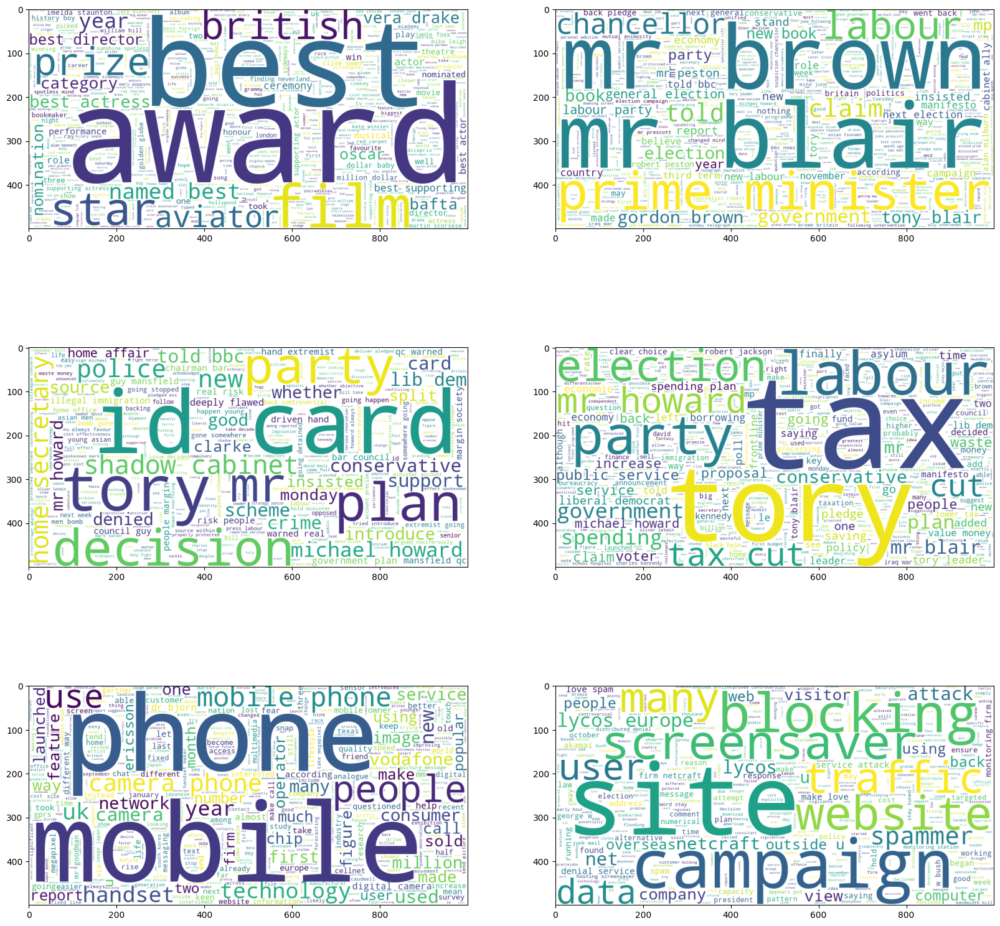

In [48]:
# DBSCAN

data['labels'] = DBSCAN_labels
fig, ax = plt.subplots(3,2,figsize=(20,20))

for i in range(n_cluster):
    df = data[data['labels'] == i]    
    ax[i//2][i%2].imshow(draw_wordcloud(df.text));

In [49]:
data.groupby(by='labels').count()

,category,filename,title,content,raw_text,text
labels,,,,,,
-1,2159,2159,2159,2159,2159,2159
0,20,20,20,20,20,20
1,16,16,16,16,16,16
2,5,5,5,5,5,5
3,8,8,8,8,8,8
4,12,12,12,12,12,12
5,5,5,5,5,5,5


Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:**

- KMeans. Все очень хорошо и понятно. Кластеры разбиты в целом очень очевидно и в соответствии с изначальной разметкой. Еще коментарии к кластерам были даны в первом задании по текстам

- Spectral. В целом очень похож на KMeans, с некоторым отличием в ключевых словах. Ну в целом в какой то степени ожидаемо, учитывая отбор признаков при помощи собственных значений.

- DBSCAN. Некоторый ужас. Слишком большое количество выброшенных значений. Может быть DBSCAN плохо работает с разряженными данными (?)

In [295]:
text_transformed = pd.DataFrame(text_transformed.toarray())
text_transformed

,0,1,2,3,4,5,6,7,8,9,...,592,593,594,595,596,597,598,599,600,601
0,0.000000,0.000000,0.000000,0.126730,0.0,0.000000,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0
1,0.000000,0.000000,0.000000,0.217076,0.0,0.000000,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.029458,0.000000,0.149581,0.0
2,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.100065,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.052406,0.0,0.000000,0.000000,0.000000,0.0
3,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.000000,0.050030,0.037534,0.0,0.138106,0.073698,0.000000,0.0
4,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.050343,0.107458,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2220,0.061038,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.060963,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.031927,0.0,0.000000,0.000000,0.000000,0.0
2221,0.000000,0.000000,0.000000,0.000000,0.0,0.080859,0.0,0.000000,0.0,0.0,...,0.000000,0.000000,0.000000,0.052065,0.000000,0.0,0.000000,0.000000,0.000000,0.0
2222,0.000000,0.000000,0.034893,0.000000,0.0,0.000000,0.0,0.076099,0.0,0.0,...,0.000000,0.000000,0.040143,0.026562,0.019927,0.0,0.036661,0.039128,0.000000,0.0
2223,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.059846,0.0,0.0,...,0.000000,0.147575,0.000000,0.000000,0.000000,0.0,0.057663,0.000000,0.000000,0.0


In [298]:
X_embedded = TSNE().fit_transform(text_transformed)
text_transformed.columns = text_transformed.columns.astype(str)
X_embedded = pd.DataFrame(X_embedded)
X_embedded['labels_KMeans'] = labels_KMeans
X_embedded['labels_Spectral'] = labels_Spectral
X_embedded['DBSCAN_labels'] = DBSCAN_labels

In [299]:
X_embedded.head()

,0,1,labels_KMeans,labels_Spectral,DBSCAN_labels
0,19.713045,-21.011497,0,3,-1
1,48.168690,-13.845559,4,3,-1
2,21.494333,-0.296999,0,1,-1
3,21.464741,-23.040148,0,3,-1
4,13.983434,-11.615337,0,1,-1


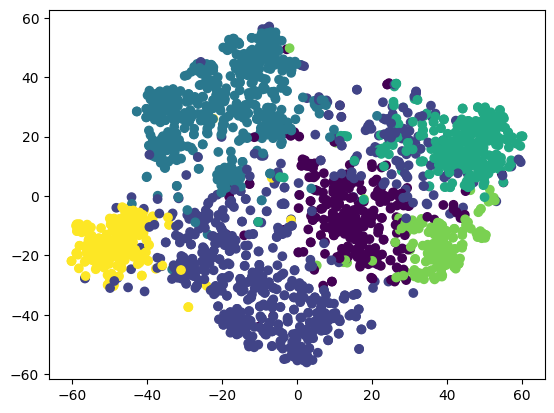

In [302]:
# Labels of KMeans

plt.scatter(x=X_embedded[0], y=X_embedded[1], c=X_embedded['labels_KMeans'])

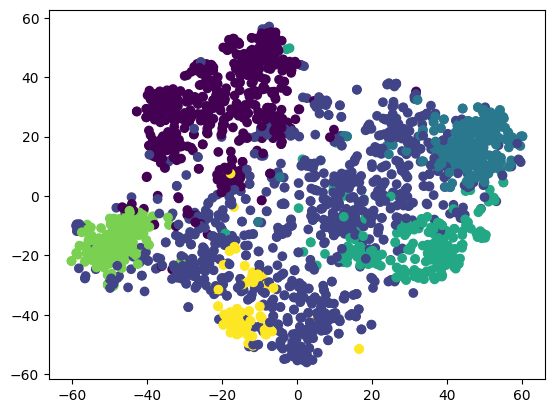

In [303]:
# Labels of Spectral

plt.scatter(x=X_embedded[0], y=X_embedded[1], c=X_embedded['labels_Spectral'])

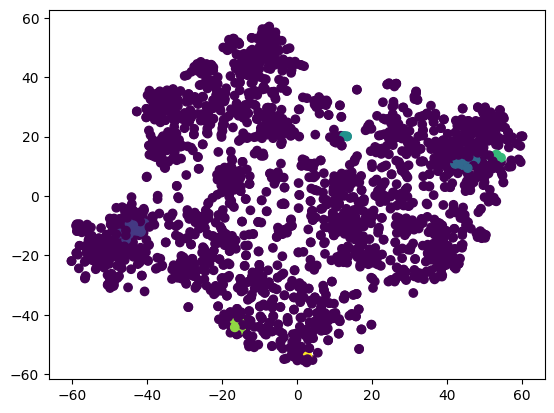

In [305]:
# Labels of DBSCAN (Purle are considered noise (-1 class))

plt.scatter(x=X_embedded[0], y=X_embedded[1], c=X_embedded['DBSCAN_labels'])

**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means. Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:**

In [50]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer


In [51]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
LDA = LatentDirichletAllocation(n_components=15)
bag_of_words = CountVectorizer().fit_transform(data['text'])

LDA_labels = LDA.fit_transform(bag_of_words).argmax(axis=1)
LDA_labels

array([ 6, 13,  1, ...,  4, 10,  8], dtype=int64)

Для выбора кластера возьму просто argmax по вероятности

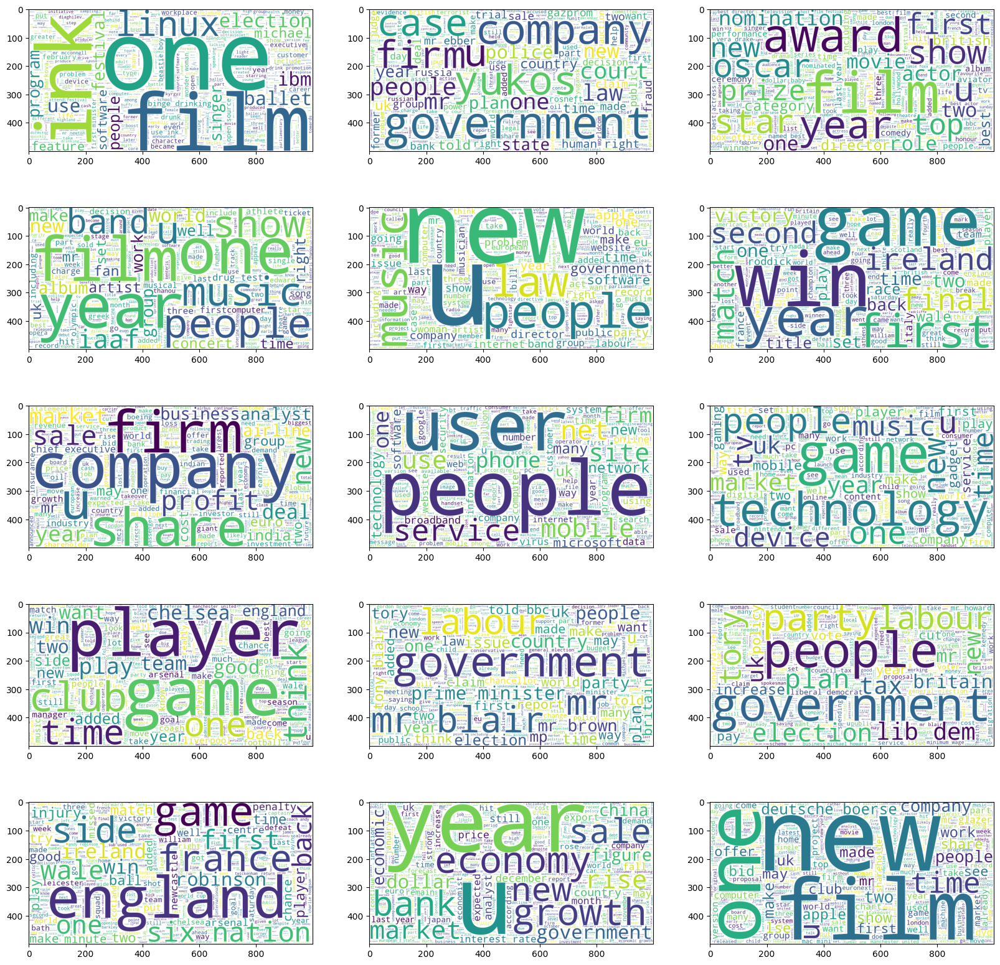

In [52]:
# LDA

data['labels'] = LDA_labels
fig, ax = plt.subplots(5,3,figsize=(20,20))

for i in range(15):
    df = data[data['labels'] == i]    
    ax[i//3][i%3].imshow(draw_wordcloud(df.text));

Выглядит стремновато. Получилось большое количество кластеров, но более точного разбиения на подтемы я не замечаю. Похоже, что темы разбиваются на подтемы по ключевым словам и возможно по популярности этих ключевых слов

## Часть 3. Transfer learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

**Logistic Regression over TF-IDF**

In [53]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

from sklearn.feature_selection import SelectFromModel

In [54]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
df_tf = pd.DataFrame(text_transformed.toarray())
le = LabelEncoder()

df_tf['category'] = le.fit_transform(data['category'])
df_tf.sample(5)

,0,1,2,3,4,5,6,7,8,9,...,593,594,595,596,597,598,599,600,601,category
1124,0.0,0.000000,0.000000,0.0,0.0,0.0,0.083304,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.037409,0.0,0.000000,0.0,0.000000,0.000000,2
1816,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.000000,0.0,0.105925,0.0,0.000000,0.000000,3
1132,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.076201,0.0,0.140191,0.0,0.000000,0.000000,2
530,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,...,0.0,0.107587,0.213565,0.000000,0.0,0.049128,0.0,0.124732,0.119144,1
1870,0.0,0.131168,0.050823,0.0,0.0,0.0,0.000000,0.0,0.0,0.041201,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.064751,4


In [55]:
data.groupby(by='category').count()

,filename,title,content,raw_text,text,labels
category,,,,,,
business,510,510,510,510,510,510
entertainment,386,386,386,386,386,386
politics,417,417,417,417,417,417
sport,511,511,511,511,511,511
tech,401,401,401,401,401,401


Распределение на классы в оригинальной выборке в целом равномерно, можно оценивать по accuracy score

In [56]:
X_train, X_test, y_train, y_test = train_test_split(df_tf.drop('category', axis=1), df_tf['category'], test_size=0.3, random_state=42)

In [57]:
# Попробуем с logreg
lgr = LogisticRegression()
lgr.fit(X_train, y_train)
pred = lgr.predict(X_test)
accuracy_score(y_true=y_test, y_pred=pred)

0.9535928143712575

In [58]:
# Проведем отбор фич с помощью l1 

lgr = LogisticRegression(penalty='l1', C=1., solver='liblinear').fit(df_tf.drop('category', axis=1), df_tf['category'])
l1_transformer = SelectFromModel(lgr, prefit=True)
X_new = l1_transformer.transform(df_tf.drop('category', axis=1))
X_new.shape

(2225, 202)

In [59]:
# Протестируем на новых признаках логрег

X_train, X_test, y_train, y_test = train_test_split(X_new, df_tf['category'], test_size=0.3, random_state=42)
lgr = LogisticRegression()
lgr.fit(X_train, y_train)
pred = lgr.predict(X_test)
accuracy_score(y_true=y_test, y_pred=pred)

0.9491017964071856

После отбора фич точность почти не упала. Однако все равно это можно было не делать, так как изначальные данные и так занимают не много места, тк хранятся в sparse-matrix формате

**K-Means over TF-IDF + Logistic Regression over the distance to centroids**

In [60]:
# Трансформируем признаки в расстояние до центроидов каждого кластера

Kmeans = KMeans(n_clusters=5)
Kmeans.fit(X_train) # фитим не всю выборку, а только трейн, чтобы избежать возможных утечек
X_train_new = Kmeans.transform(X_train)
X_test_new = Kmeans.transform(X_test)

In [61]:
# Зафитим логрег, как истинные метки используем классы из данных

lgr.fit(X_train_new, y_train)
pred = lgr.predict(X_test_new)
accuracy_score(y_true=y_test, y_pred=pred)

0.7574850299401198

In [62]:
# Если обучать на кластерах из KMeans а потом пытаться предсказывать настоящие классы, ну... Результат удивил)))

y_train_new = Kmeans.predict(X_train)

lgr.fit(X_train_new, y_train_new)
pred = lgr.predict(X_test_new)
accuracy_score(y_true=y_test, y_pred=pred)

0.1691616766467066

**Logistic Regression over LDA probabilities**

In [63]:
bag_of_words_df = pd.DataFrame(bag_of_words.toarray())
bag_of_words_df['category'] = df_tf['category']

In [64]:
X_train, X_test, y_train, y_test = train_test_split(bag_of_words_df.drop('category', axis=1), bag_of_words_df['category'], test_size=0.3, random_state=42)

In [65]:
LDA = LatentDirichletAllocation(n_components=5)
X_train_new = LDA.fit_transform(X_train)
X_test_new = LDA.transform(X_test)

lgr.fit(X_train_new, y_train)
pred = lgr.predict(X_test_new)
accuracy_score(y_true=y_test, y_pred=pred)

0.8622754491017964

У какой модели получилось лучшее качество? С чем это связано?

**Ответ:**

Наибольшее качество у Logreg над TF-IDF признаками. Возможно это связано с тем, что модель получает прямые неизмененные признаки, как это происходит в других случаях (в тех случаях критически мало фич). 

- В LogReg over TF-IDF можно даже убрать 60% признаков с помощью отбора по l1, и качество останется практически без изменений. 

- В случае с KMeans и центроидами, количества фич не совсем хватает, да и работа не то что бы стабильная (может показывать от 0.6 до 0.87 accuracy). Скорее всего это связано с недостаточным количеством признаковых описаний, да и не совсем понятно как кластеры распределены в пространстве. ( Попробовал пошалить немного и обучить модель по кластерам из KMeans и потом проверил accuracy на реальной разметке, в целом ожидаемо плохо. Наверняка связано с тем, что попросту номера кластеров не совпадают, это в целом можно пофиксить )

- При обучении LogReg поверх LDA получается неплохая точность, сопоставимая с обучением по центроидам. Точно так же, маловато фич и алгоритм не совсем стабилен (accuracy от 0.7 до 0.91). В целом неплохо

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 

In [270]:
X_train, X_test, y_train, y_test = train_test_split(data.drop(['category', 'labels', 'raw_text', 'content', 'title'], axis=1), data['category'], test_size=0.3, random_state=42)

X_train_train, X_val, y_train_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=42)

In [271]:
TF_IDF_vec = TfidfVectorizer(min_df=0.05)
text = X_train_train['text']
TF_IDF_vec.fit(text)
TF_IDF_vec.get_feature_names_out()

array(['able', 'access', 'according', 'account', 'accused', 'across',
       'act', 'action', 'actor', 'actually', 'add', 'added', 'admitted',
       'agency', 'ago', 'agreed', 'ahead', 'allow', 'allowed', 'almost',
       'already', 'also', 'although', 'always', 'american', 'among',
       'amount', 'analyst', 'announced', 'annual', 'another', 'anything',
       'appeal', 'area', 'around', 'asked', 'association', 'attack',
       'attempt', 'authority', 'available', 'average', 'award', 'away',
       'back', 'bank', 'based', 'battle', 'bbc', 'beat', 'became',
       'become', 'behind', 'belief', 'believe', 'benefit', 'best',
       'better', 'bid', 'big', 'biggest', 'bill', 'bit', 'blair', 'board',
       'body', 'book', 'boost', 'bos', 'break', 'bring', 'britain',
       'british', 'brought', 'brown', 'business', 'buy', 'ca', 'call',
       'called', 'came', 'campaign', 'career', 'case', 'centre',
       'chairman', 'challenge', 'champion', 'chance', 'change', 'charge',
       'charl

In [272]:
le.fit(y_train_train)
y_train_train = le.transform(y_train_train)
y_val = le.transform(y_val)

In [273]:
preprocessed = TF_IDF_vec.transform(X_train_train['text']).toarray()

In [274]:
Kmeans = KMeans(n_clusters=10)
labels = Kmeans.fit_predict(preprocessed)
labels

array([4, 4, 7, ..., 1, 8, 7])

In [275]:
train = pd.DataFrame(preprocessed)
train['labels'] = labels
train['true_labels'] = y_train_train
train.shape

(1089, 621)

In [276]:
train_marked = train.iloc[range(56)]

In [277]:
validation = TF_IDF_vec.transform(X_val['text']).toarray()
labels_val = Kmeans.predict(validation)
validation = pd.DataFrame(validation)
validation['labels'] = labels_val
validation['true_labels'] = y_val
validation.shape

(468, 621)

In [278]:
train_marked.columns = train_marked.columns.astype(str)
validation.columns = validation.columns.astype(str)

In [279]:
lgr = LogisticRegression()
lgr.fit(train_marked.drop('true_labels', axis=1), train_marked['true_labels']);

In [280]:
pred_on_validation = lgr.predict(validation.drop('true_labels', axis=1))
accuracy_score(y_true=validation['true_labels'], y_pred=pred_on_validation)

0.4594017094017094

In [281]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
# Finna Gridsearch

Посмотрим на точность на Test

In [282]:
y_test = le.transform(y_test)
X_test = TF_IDF_vec.transform(X_test['text']).toarray()
labels = Kmeans.predict(X_test)
X_test = pd.DataFrame(X_test)
X_test['labels'] = labels
X_test.columns = X_test.columns.astype(str)

,0,1,2,3,4,5,6,7,8,9,...,610,611,612,613,614,615,616,617,618,labels
0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.00000,0.000000,0.0,0.057573,0.000000,0.0,0.0,6
1,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.00000,0.067405,0.0,0.000000,0.067384,0.0,0.0,2
2,0.073838,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.00000,0.000000,0.0,0.036178,0.000000,0.0,0.0,4
3,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.05582,0.124983,0.0,0.153040,0.000000,0.0,0.0,2
4,0.000000,0.0,0.0,0.0,0.0,0.0,0.050517,0.041438,0.0,0.0,...,0.0,0.0,0.00000,0.044215,0.0,0.000000,0.000000,0.0,0.0,8


In [283]:
pred = lgr.predict(X_test)
accuracy_score(y_true=y_test, y_pred=pred)

0.49850299401197606

Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:**

Как можно видеть, если обучить на всем трейне TF-IDF и KMeans и из KMeans получить новые лейблы, то даже на 0.035% всего датасета можно обучить логистическую регрессию с точностью около 50% (классы равномерно распределены)

Было замечено, что 10 классов в KMeans в целом довольно таки оптимально, если сдвигаться вверх или вниз получается точность ниже

## Бонус

**Задание 4 (1 балл)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

In [71]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 5 (1 балл)**. На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [72]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [73]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 7 (1 балл)**. Наконец, ставший ежегодной традицией социализационный бонус. Мы поощряем не только предметное, но и духовное развитие. Поэтому, чтобы заработать балл за это задание, сходите на какую-нибудь выставку или в музей, напишите небольшой отчетик о ваших впечатлениях и добавьте фотопруфы в ноутбук при сдаче. Можете объединиться с одногруппниками/однокурсниками, а также пригласить ассистентов/преподавателей, они тоже будут рады выбраться куда-нибудь. Для вдохновения приведем ссылку на актуальные выставки [новой](https://www.youtube.com/watch?v=dQw4w9WgXcQ&ab) и [старой Третьяковки](https://www.youtube.com/watch?v=xm3YgoEiEDc) (но совсем не обязательно посещать именно их).

In [74]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻

Я никуда не сходил(((

Ну вернее сходил в бильярд с друзьями, не сильно культурно, но прикольно. Тоже сходите, на трехсвяте 8 шаров